## Process gene expression profiles


Once alignment has completed the data can be aggregated into gene expression matricies. In this example we are downloading precomputed gene expression matrices for human gene expression signatures. The Jupyter Notebook compares the gene count level data created by 5 alignment tools. It then calculates differential gene expression using limma. The performance of alignment tools is then compared with respect to number of differential genes detected and number of significantly enriched terms from enrichment analysis.

Install some pre-requisites and libraries, this might take some time.

In [1]:
setwd("/alignment")

library("plyr")
library("stringr")

library("R.utils")
library("RCurl")
library("data.table")

library("DESeq2")
library("limma")
library("statmod")
library("edgeR")
library("enrichR")


Loading required package: R.oo
Loading required package: R.methodsS3
R.methodsS3 v1.7.1 (2016-02-15) successfully loaded. See ?R.methodsS3 for help.
R.oo v1.22.0 (2018-04-21) successfully loaded. See ?R.oo for help.

Attaching package: ‘R.oo’

The following objects are masked from ‘package:methods’:

    getClasses, getMethods

The following objects are masked from ‘package:base’:

    attach, detach, gc, load, save

R.utils v2.9.0 successfully loaded. See ?R.utils for help.

Attaching package: ‘R.utils’

The following object is masked from ‘package:utils’:

    timestamp

The following objects are masked from ‘package:base’:

    cat, commandArgs, getOption, inherits, isOpen, parse, warnings

Loading required package: bitops

Attaching package: ‘RCurl’

The following object is masked from ‘package:R.utils’:

    reset

The following object is masked from ‘package:R.oo’:

    clone

Loading required package: S4Vectors
Loading required package: stats4
Loading required package: BiocGener

Download precomputed gene expression matrices for kallisto, Salmon, BWA, HISAT2, and STAR 

In [2]:
download.file("https://mssm-alignment-benchmark.s3.amazonaws.com/kallisto_expression.tsv", "/alignment/supportfiles/kallisto_expression.tsv")
download.file("https://mssm-alignment-benchmark.s3.amazonaws.com/salmon_expression.tsv", "/alignment/supportfiles/salmon_expression.tsv")
download.file("https://mssm-alignment-benchmark.s3.amazonaws.com/bwa_expression.tsv", "/alignment/supportfiles/bwa_expression.tsv")
download.file("https://mssm-alignment-benchmark.s3.amazonaws.com/star_expression.tsv", "/alignment/supportfiles/star_expression.tsv")
download.file("https://mssm-alignment-benchmark.s3.amazonaws.com/hisat2_expression.tsv", "/alignment/supportfiles/hisat2_expression.tsv")

In [3]:
kallisto = fread("/alignment/supportfiles/kallisto_expression.tsv")
genes = unlist(kallisto[,1])
kallisto = as.matrix(kallisto[,-1])
rownames(kallisto) = genes

star = fread("/alignment/supportfiles/star_expression.tsv")
genes = unlist(star[,1])
star = as.matrix(star[,-1])
rownames(star) = genes

hisat2 = fread("/alignment/supportfiles/hisat2_expression.tsv")
genes = unlist(hisat2[,1])
hisat2 = as.matrix(hisat2[,-1])
rownames(hisat2) = genes

bwa = fread("/alignment/supportfiles/bwa_expression.tsv")
genes = unlist(bwa[,1])
bwa = as.matrix(bwa[,-1])
rownames(bwa) = genes

salmon = fread("/alignment/supportfiles/salmon_expression.tsv")
genes = unlist(salmon[,1])
salmon = as.matrix(salmon[,-1])
rownames(salmon) = genes

ll = list(kallisto, salmon, bwa, hisat2, star)
names(ll) = c("kallisto", "Salmon", "BWA", "HISAT2", "STAR")

Warning message in fread("/alignment/supportfiles/kallisto_expression.tsv"):
“Detected 356 column names but the data has 357 columns (i.e. invalid file). Added 1 extra default column name for the first column which is guessed to be row names or an index. Use setnames() afterwards if this guess is not correct, or fix the file write command that created the file to create a valid file.”Warning message in fread("/alignment/supportfiles/star_expression.tsv"):
“Detected 356 column names but the data has 357 columns (i.e. invalid file). Added 1 extra default column name for the first column which is guessed to be row names or an index. Use setnames() afterwards if this guess is not correct, or fix the file write command that created the file to create a valid file.”Warning message in fread("/alignment/supportfiles/hisat2_expression.tsv"):
“Detected 356 column names but the data has 357 columns (i.e. invalid file). Added 1 extra default column name for the first column which is guessed to be 

Plot the correlation of gene expression profiles for matched samples for pairs of alignment tools.

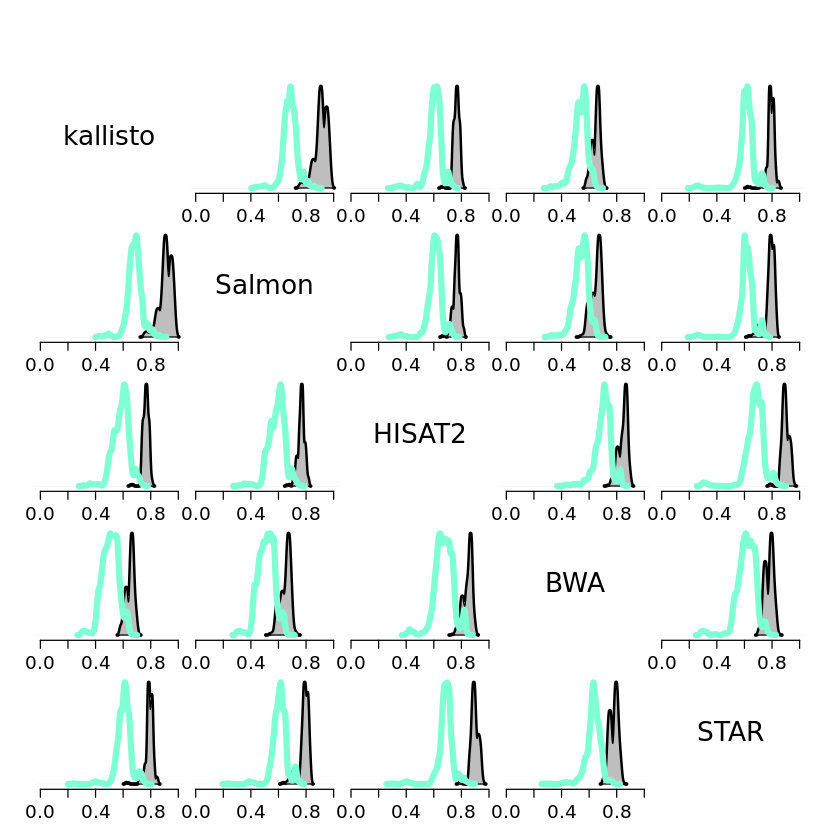

In [5]:
par(oma=c(3,2,3,2))
par(mfrow=c(5,5))
par(mar=c(0.2,0.2,0.2,0.2))

for(i in c(1,2,4,3,5)){
    
    ddx = c()
    
    for(j in c(1,2,4,3,5)){
        if(i == j){
            plot(c(0, 1), c(0, 1), ann = F, bty = 'n', type = 'n', xaxt = 'n', yaxt = 'n')
            text(x = 0.5, y = 0.4, names(ll)[i], cex=2)
        }
        else{
            cc = cor(ll[[i]], ll[[j]], method="spearman")
            dd = diag(cc)
            ww = which(!is.na(dd))
            ddx = c(ddx, dd[ww])
            de = density(dd[ww])
            de$y = de$y/max(de$y)
            de2 = density(cc[upper.tri(cc)], na.rm=T)
            de2$y = de2$y/max(de2$y)
            plot(de, lwd=3, main="", xlab="", ylab="", ylim=c(0,1.3), xlim=c(0,1), yaxt = 'n', frame.plot=F, cex.axis=1.4)
            polygon(de, col="grey", border="black")
            lines(de2, col="aquamarine", lwd=5)
        }
    }
}

In [4]:
diffExpression <- function(controls, samples){
    expression = do.call(cbind, append(controls, samples))
    
    design = c(rep(1,length(controls)), rep(-1, length(samples)))
    dm = model.matrix(~as.factor(design))
    
    dge <- DGEList(counts=expression)
    dge <- calcNormFactors(dge)
    
    v <- voom(dge, dm, plot=TRUE)
    
    fit <- lmFit(v, dm)
    fit <- eBayes(fit)
    
    r1 = fit$p.value[,2]
    r2 = fit$t[,2]
    
    return(r2)
}

Load information about the differential gene expression profiles. This includes information about control and treatment samples. Then calculate the differential gene expression using the limma package.

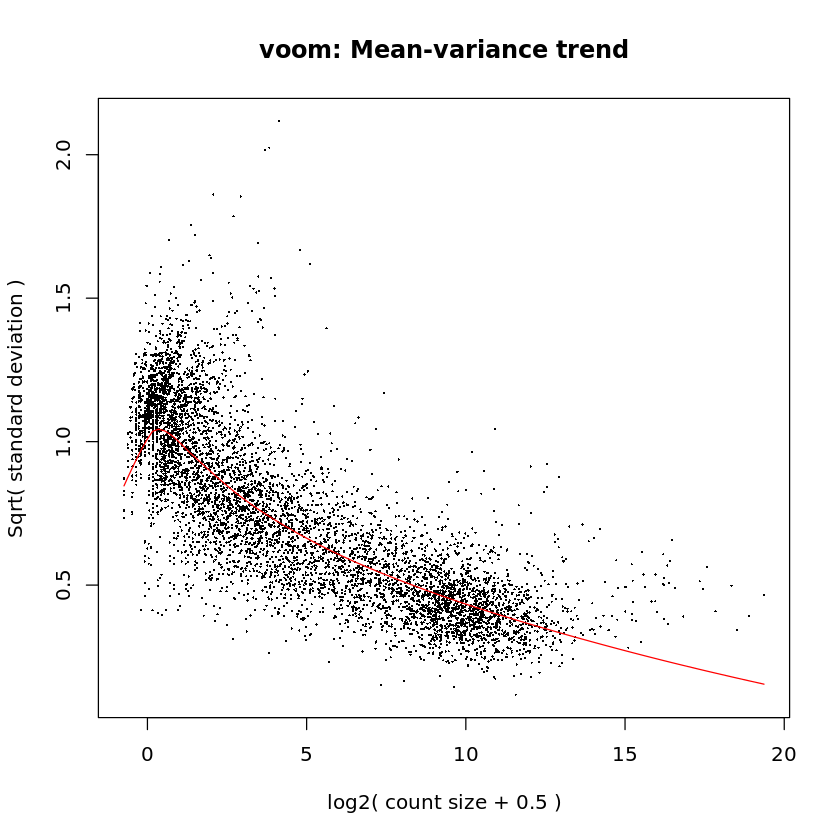

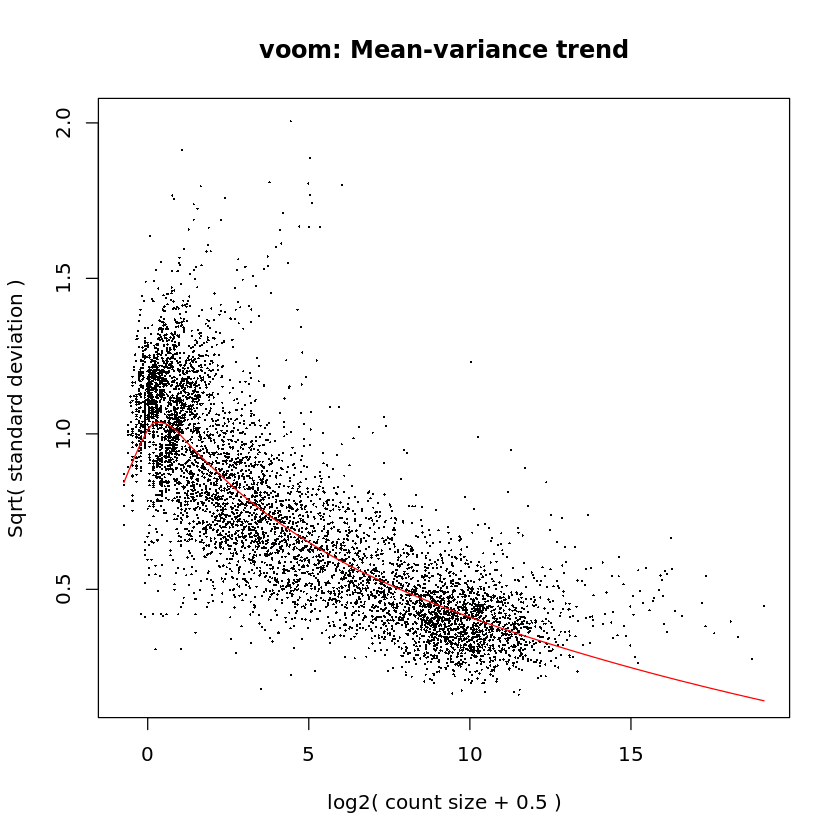

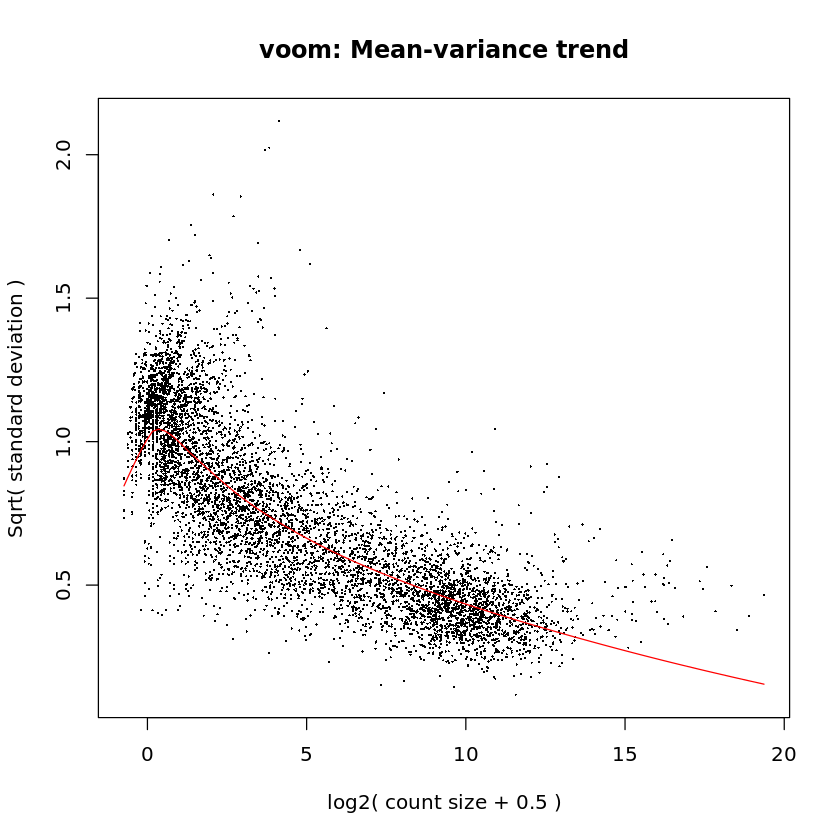

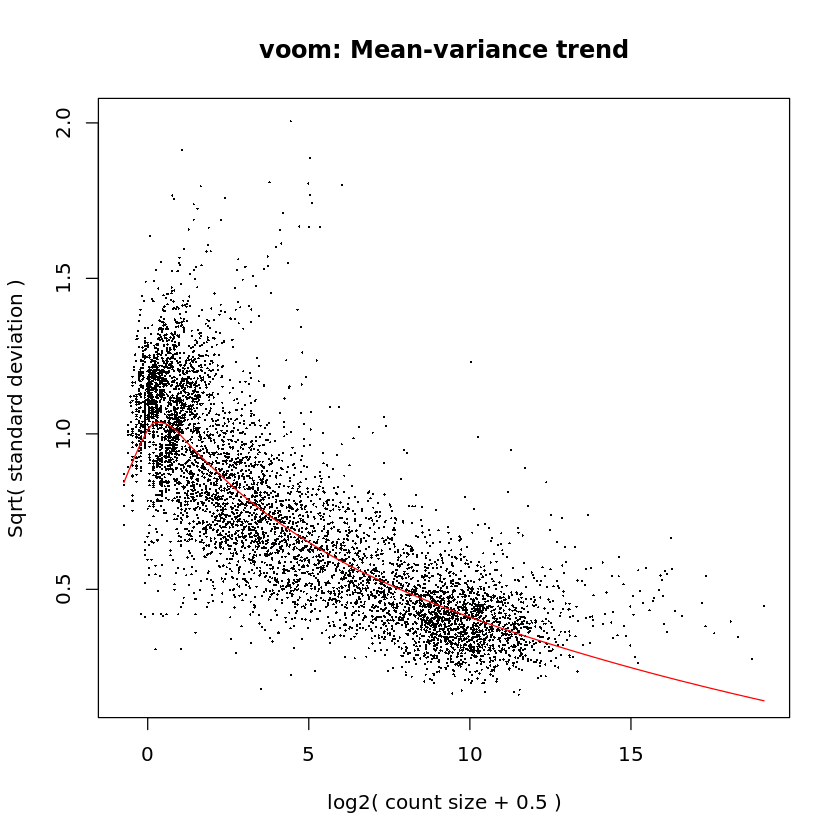

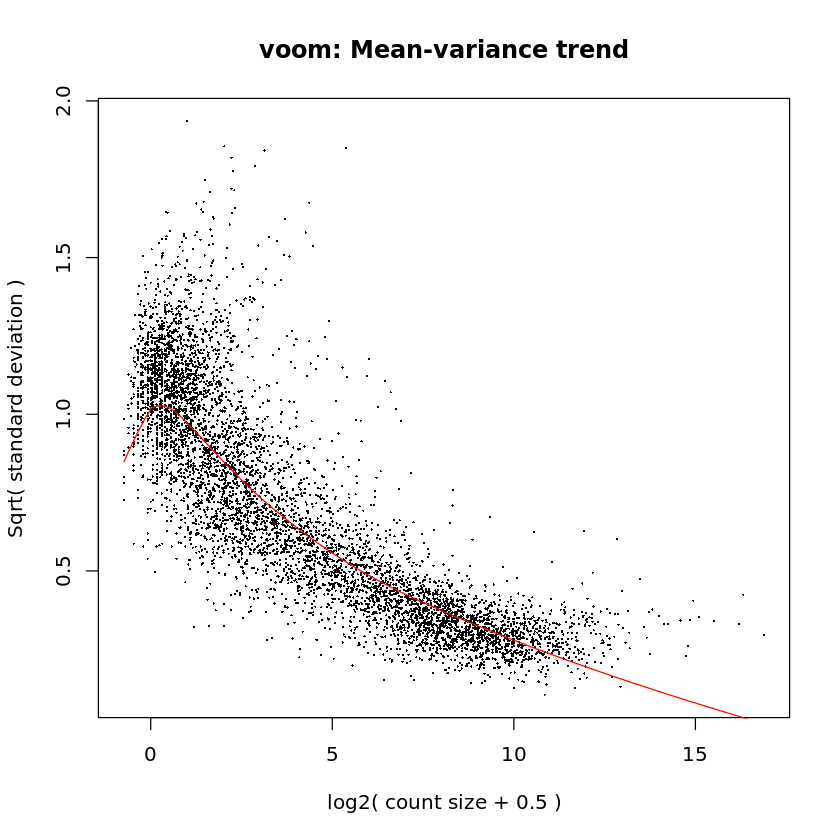

...

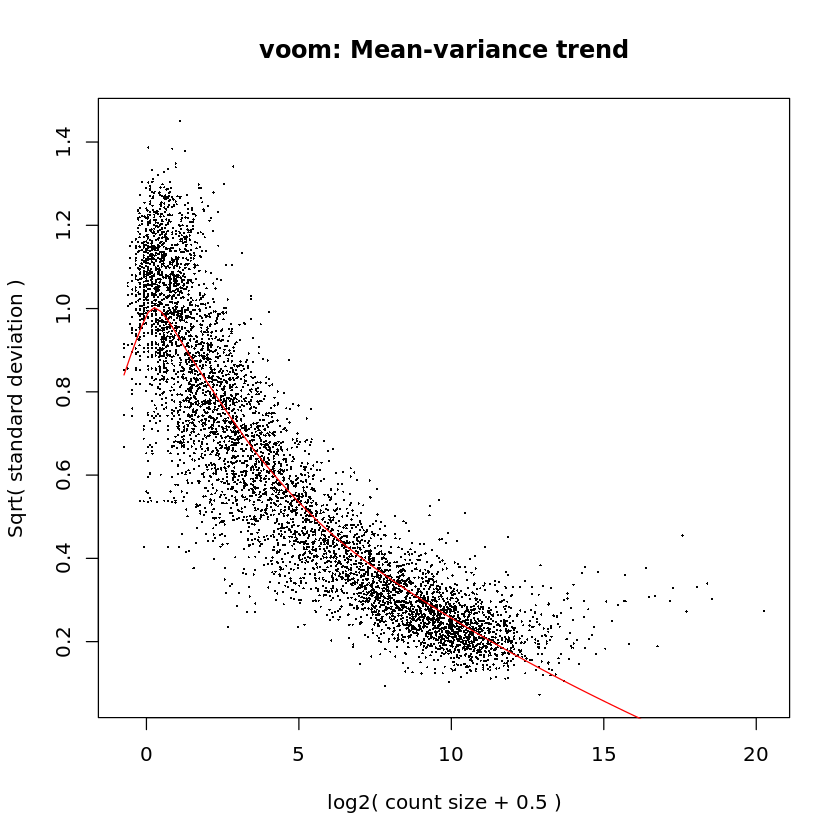

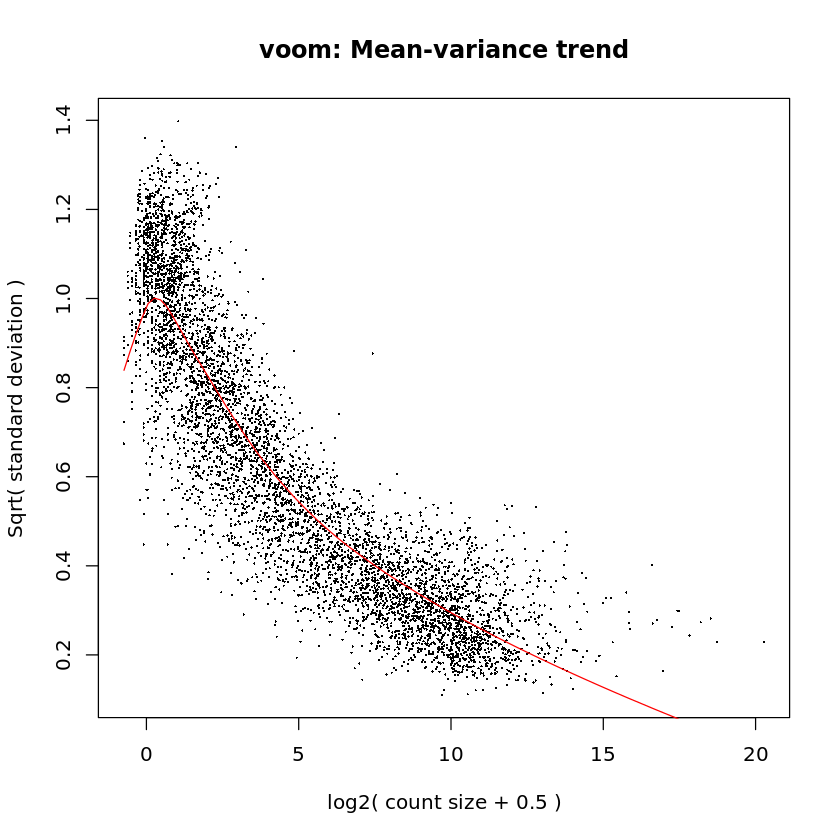

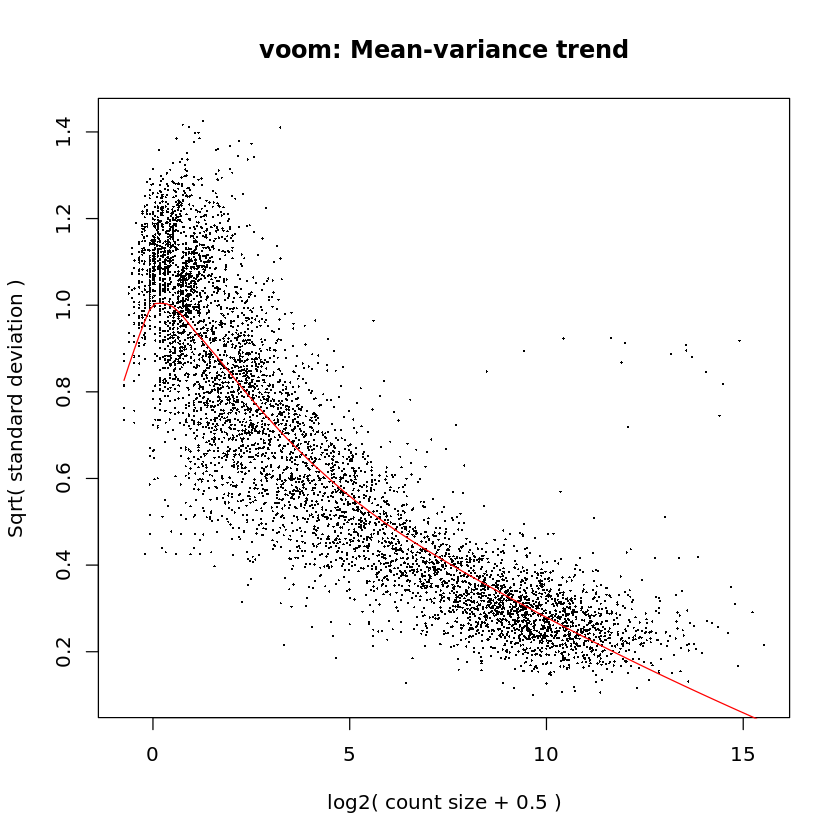

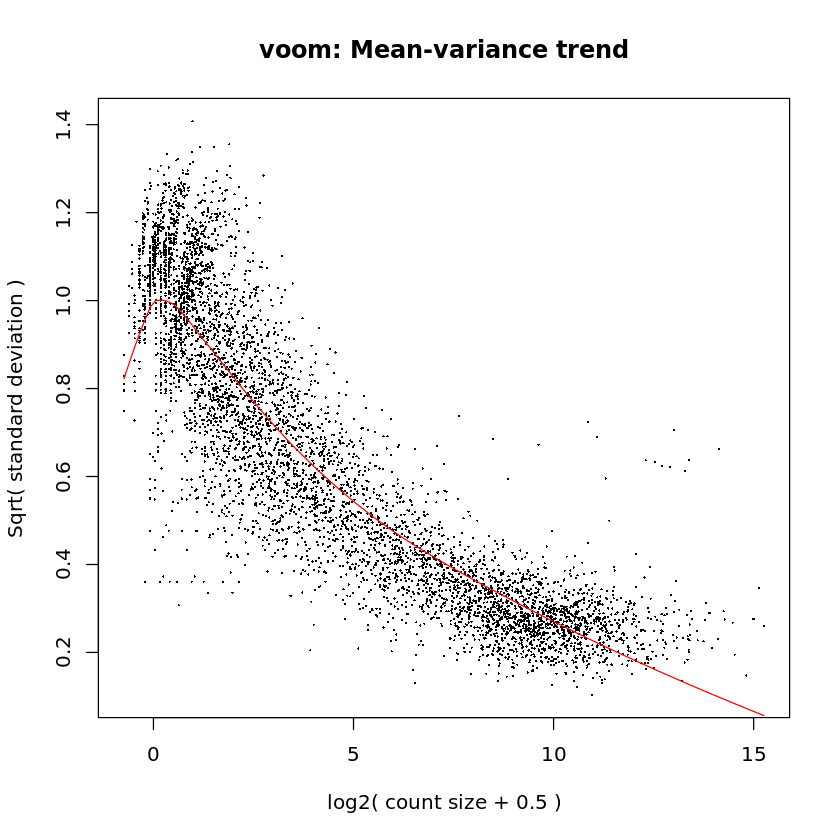

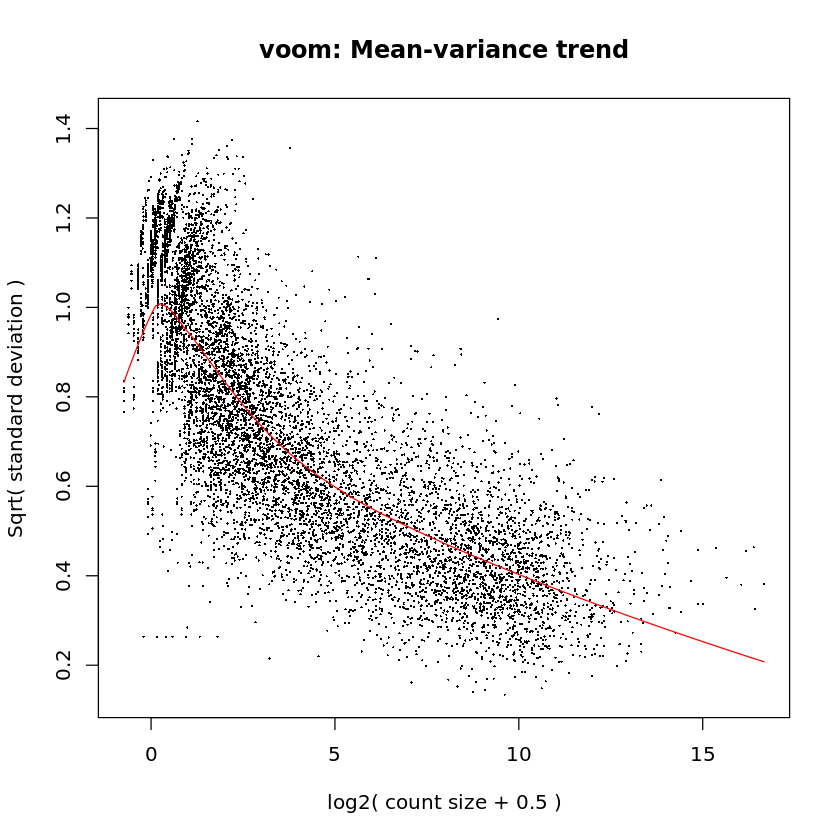

In [ ]:
signatures = read.table("/alignment/supportfiles/signatures.tsv", stringsAsFactors=F, sep="\t", fill=T, quote="", header=T)
sampleMap = read.table("/alignment/supportfiles/human_samplemapping.tsv", stringsAsFactors=F, sep="\t", fill=T, quote="", header=T)

whuman = which(signatures[,14] == "homo sapiens")

controlList = list()
perturbationList = list()

for(co in whuman){
    controlList[[length(controlList)+1]] = sort(unlist(c(strsplit(signatures[co, 6], ","), strsplit(signatures[co,10], ","))))
    perturbationList[[length(perturbationList)+1]] = sort(unlist(c(strsplit(signatures[co,7], ","), strsplit(signatures[co,9], ","))))
}

ww = which((lapply(perturbationList,length) == 3) & (lapply(controlList,length)  == 3))

controlList = controlList[ww]
perturbationList = perturbationList[ww]
signaturesHuman = signatures[whuman,][ww,]

perturbation_type_count = table(signaturesHuman[,11])


diffList = list()

for(i in c(1,2,4,3,5)){
    
    tmat = ll[[i]]
    wk = which(colSums(tmat) > 0)
    tmat = tmat[,wk]
    
    diffy = list()
    
    for(j in 1:nrow(signaturesHuman)){
        controlCounts = list()
        for(sample in controlList[[j]]){
            if(sample %in% colnames(tmat)){
                controlCounts[[length(controlCounts)+1]] = tmat[,sample]
            }
        }
        
        perturbationCounts = list()
        for(sample in perturbationList[[j]]){
            if(sample %in% colnames(tmat)){
                perturbationCounts[[length(perturbationCounts)+1]] = tmat[,sample]
            }
        }
        if(length(controlCounts) > 1 & length(perturbationCounts) > 1){
            diffy[[length(diffy)+1]] = diffExpression(controlCounts, perturbationCounts)
            names(diffy)[length(diffy)] = i
        }
    }
    
    diffList[[length(diffList)+1]] = do.call(cbind, diffy)
}

names(diffList) = names(ll)

In [ ]:
par(oma=c(3,2,3,2))
par(mfrow=c(5,5))
par(mar=c(0.2,0.2,0.2,0.2))

for(i in c(1,2,3,4,5)){
    
    ddx = c()
    
    for(j in c(1,2,3,4,5)){
        if(i == j){
            plot(c(0, 1), c(0, 1), ann = F, bty = 'n', type = 'n', xaxt = 'n', yaxt = 'n')
            text(x = 0.5, y = 0.4, names(diffList)[i], cex=2)
        }
        else{
            cc = cor(diffList[[i]], diffList[[j]], method="pearson")
            dd = diag(cc)
            ww = which(!is.na(dd))
            ddx = c(ddx, dd[ww])
            de = density(dd[ww])
            de$y = de$y/max(de$y)
            de2 = density(cc[upper.tri(cc)], na.rm=T)
            de2$y = de2$y/max(de2$y)
            plot(de, lwd=3, main="", xlab="", ylab="", ylim=c(0,1.3), xlim=c(-0.2,1), yaxt = 'n', frame.plot=F, cex.axis=1.4)
            polygon(de, col="grey", border="black")
            lines(de2, col="aquamarine", lwd=5)
        }
    }
}

Identify up and down regulated genes for each signature and plot

In [ ]:
updown = list()

for(i in 1:5){
    upgc = c()
    downgc = c()
    for(j in 1:ncol(diffList[[i]])){
        wwu = which(diffList[[i]][,j] > 5)
        wwd = which(diffList[[i]][,j] < -5)
        print(paste(length(wwu), length(wwd)))
        upgc = c(upgc, length(wwu))
        downgc = c(downgc, length(wwd))
    }
    
    updown[[length(updown)+1]] = downgc
    updown[[length(updown)+1]] = upgc
}

par(mar=c(6,6,6,6))
boxplot(updown, lwd=2, outline=F, col=c("aquamarine", "lightpink"), ylab="differntial expressed genes", labels="", cex.lab=1.6, cex.axis=1.6, xaxt="n", ylim=c(-100, 1600))

text(x=1.5, y=-80, labels="kallisto", cex=1.6)
text(x=3.5, y=-80, labels="Salmon", cex=1.6)
text(x=5.5, y=-80, labels="STAR", cex=1.6)
text(x=7.5, y=-80, labels="HISAT2", cex=1.6)
text(x=9.5, y=-80, labels="BWA", cex=1.6)

abline(v=(0.5+2*(1:4)), lwd=1)
legend("topleft", legend=c("up-regulated", "down-regulated"), fill=c("aquamarine", "lightpink"), cex=1.4, bg="white")


Plot 

In [ ]:
sample_count = list()
for(i in 1:5){
    cs = colSums(ll[[i]])
    cs = cs[cs !=0]
    sample_count[[length(sample_count)+1]] = cs
    
}
names(sample_count) = names(ll)

sample_count = sample_count[c(1,2,4,3,5)]

scm = do.call(cbind, sample_count)

log2mean<- function(x) {
    x = x[x != 0]
    x <- log2(1+x)
    return = mean(x)
}

par(mar=c(6,6,6,6))
plot(1:5, log2(scm[1,]+1), type="b", pch=20, ylim=c(20, 26), cex.lab=1.6, cex.axis=1.6, xlab="", ylab="log2 sum of gene counts", xaxt="n")
for(i in 2:nrow(scm)){
    lines(1:5, log2(scm[i,]+1), type="b", pch=20, col=rgb(0,0,0,0.2))
}
axis(1, 1:5, names(sample_count), cex.axis=1.6)
lines(1:5, unlist(lapply(sample_count, log2mean)), type="b", col="red", lwd=4, pch=20, cex=2)
legend("topleft", legend=c("sample", "mean trend"), pch=20, col=c("grey", "red"), lwd=c(1,3), border=F, cex=2)

Calculate enrichment analysis for a selected set of gene set libraries using Enrichr. For enrichment analysis use the top 250 overexpressed genes from the differential gene expression profiles. Then calculate the overlap of enriched terms.

In [ ]:
dbs <- c("GO_Biological_Process_2018", "KEGG_2019_Human", "ChEA_2016", "Human_Phenotype_Ontology")

enrichment = list()

for(j in 1:length(diffList)){
    enrichList = list()
    
    for(i in 1:ncol(diffList[[j]])){
        print(i)
        oo = order(diffList[[j]][,i])
        
        up_genes = rownames(diffList[[j]])[oo[1:250]]
        
        enriched = tryCatch({
            enrichr(up_genes, dbs)
        }, warning = function(w) {
        }, error = function(e) {
            print("try again")
            enrichr(up_genes, dbs)
        }, finally = {
        })
        
        processes = c()
        for(en in enriched){
            ww = which(en[,4] < 0.05)
            processes = c(processes, en[ww,1])
        }
        
        enrichList[[length(enrichList)+1]] = processes
    }
    enrichment[[length(enrichment)+1]] = enrichList
}

overl = matrix(0, 5, 5)
colnames(overl) = names(diffList)
rownames(overl) = names(diffList)

for(i in 1:length(enrichment)){
    for(j in 1:length(enrichment)){
        
        s1 = 0
        
        for(k in 1:length(enrichment[[i]])){
            inter = intersect(enrichment[[i]][[k]], enrichment[[j]][[k]])
            s1 = s1 + length(inter)
        }
        
        overl[i,j] = s1
    }
}


In [ ]:
session()